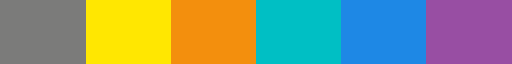

In [68]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import umap.umap_ as umap
import seaborn as sns
import plotly.express as px
from plotly.graph_objs.layout import Scene
from plotly.graph_objs.layout.scene import XAxis, YAxis, ZAxis
import plotly.graph_objects as go

# Import custom functions
from scripts.functions import *
from scripts.structure_index import compute_structure_index, draw_graph

sns.set(style='white', context='notebook')

import matplotlib as mpl
cmap = mpl.colors.ListedColormap(["#7B7B7A", "#FFE701", "#F38F0D", "#00bfc4", "#1E88E5", "#984ea3"])
state_color_map = {
    0: "#7B7B7A",
    1: "#FFE701",
    2: "#F38F0D",
    3: "#00bfc4",
    4: "#1E88E5",
    5: "#984ea3",
}
cmap

In [ ]:
all_norm_waveforms = pd.concat([pd.DataFrame(norm_waveform1.T),
                                pd.DataFrame(norm_waveform2.T),
                                pd.DataFrame(norm_waveform3.T),
                                pd.DataFrame(norm_waveform4.T),
                                pd.DataFrame(norm_waveform5.T)])

In [ ]:
all_norm_data = pd.concat([all_metrics, all_norm_waveforms], axis=1)

In [ ]:
all_norm_data.to_hdf('PFC_normalized_if_cycles_data.h5', key=f'Rat_{rat}', mode='a', format='table')

In [ ]:
# Get phase-aligned cycle waveforms
wave1, _ = emd.cycles.phase_align(IP1, filtered_pfc_data1, cycles=cycles1.iterate(through='subset'), npoints=128)
wave1 = pd.DataFrame(wave1.T)
wave2, _ = emd.cycles.phase_align(IP2, filtered_pfc_data2, cycles=cycles2.iterate(through='subset'), npoints=128)
wave2 = pd.DataFrame(wave2.T)
wave3, _ = emd.cycles.phase_align(IP3, filtered_pfc_data3, cycles=cycles3.iterate(through='subset'), npoints=128)
wave3 = pd.DataFrame(wave3.T)
wave4, _ = emd.cycles.phase_align(IP4, filtered_pfc_data4, cycles=cycles4.iterate(through='subset'), npoints=128)
wave4 = pd.DataFrame(wave4.T)
wave5, _ = emd.cycles.phase_align(IP5, filtered_pfc_data5, cycles=cycles5.iterate(through='subset'), npoints=128)
wave5 = pd.DataFrame(wave5.T)

In [ ]:
inds = all_metrics[all_metrics['Post_Trial'] == 5]['index']

In [ ]:
all_metrics[(all_metrics['Post_Trial'] == 5) & (all_metrics['peak_position']/all_metrics['duration'] <=0.1)]

In [ ]:
index = 10

In [ ]:
fig, axes = plt.subplots(2, 1, figsize=(5, 6))

axes[0].plot(IF5[cycles5.get_inds_of_cycle(inds[index])]);
axes[0].set_title('IF')
axes[1].plot(waveforms5.T[index]);
axes[1].set_title('Aligned IF')
plt.tight_layout()

In [ ]:
fig, axes = plt.subplots(4, 1, figsize=(5, 12))

axes[0].plot(filtered_pfc_data5[cycles5.get_inds_of_cycle(inds[index])]);
axes[0].set_title('Actual Waveform')
axes[1].plot(resampled_waveforms5[index]);
axes[1].set_title('Resampled Waveform')
axes[2].plot(norm_waveform5.T[index]);
axes[2].set_title('Normalized IF Waveform')
axes[3].plot(wave5.T[index]);
axes[3].set_title('Normalized Waveform')
plt.tight_layout()

In [ ]:
plt.plot(resampled_waveforms5[index]);

In [ ]:
all_waveforms = pd.concat([wave1, wave2, wave3, wave4, wave5])

In [ ]:
all_data = pd.concat([all_metrics, all_waveforms], axis=1)

In [ ]:
all_data.to_hdf('PFC_normalized_cycles_data.h5', key=f'Rat_{rat}', mode='a', format='table')

In [ ]:
from tqdm import tqdm

def resampled_waveforms(data, cycles, metrics):
    waveforms = np.zeros((128, metrics.shape[0]))*np.nan
    for i, inds in tqdm(cycles.iterate(through='subset')):
        values = data[inds]
        time = np.arange(len(values))
        time_normalized = time / (len(values) - 1)
        t_new = np.linspace(0, 1, 128)
        func = interp1d(time_normalized, values, kind='linear')
        v_new = func(t_new)
        waveforms[:, i] = v_new
    return waveforms

In [ ]:
resampled_waveform1 = resampled_waveforms(filtered_pfc_data1, cycles1, metrics1)
resampled_waveform2 = resampled_waveforms(filtered_pfc_data2, cycles2, metrics2)
resampled_waveform3 = resampled_waveforms(filtered_pfc_data3, cycles3, metrics3)
resampled_waveform4 = resampled_waveforms(filtered_pfc_data4, cycles4, metrics4)
resampled_waveform5 = resampled_waveforms(filtered_pfc_data5, cycles5, metrics5)

In [ ]:
all_resampled_waveforms = pd.concat([pd.DataFrame(resampled_waveform1.T),
                                pd.DataFrame(resampled_waveform2.T),
                                pd.DataFrame(resampled_waveform3.T),
                                pd.DataFrame(resampled_waveform4.T),
                                pd.DataFrame(resampled_waveform5.T)])

In [ ]:
all_resampled_data = pd.concat([all_metrics, all_resampled_waveforms], axis=1)

In [ ]:
all_resampled_data.to_hdf('PFC_resampled_cycles_data.h5', key=f'Rat_{rat}', mode='a', format='table')

In [ ]:
all_norm_data.to_hdf('PFC_normalized_if_cycles_data.h5', key=f'Rat_{rat}', mode='w', format='table')

# Load Data

In [2]:
rat = '6'
condition = 'OR_N'
region = 'PFC'

In [3]:
Rat_data = pd.read_hdf(f'./cycles_data/{region}_resampled_cycles_data.h5', f'Rat_{rat}_{condition}')
# Rat_data = Rat_data[Rat_data['max_amp'] >= np.percentile(Rat_data['max_amp'], 0)]
metrics = Rat_data.iloc[:, :-128]
waveforms = np.array(Rat_data.iloc[:, -128:])

In [4]:
metrics

,index,is_good,start_sample,stop_sample,duration,duration_samples,peak2trough,asc2desc,max_amp,trough_values,peak_values,mean_if,max_if,range_if,trough_position,peak_position,chain_ind,State,Post_Trial,cycle_time
0,1,1,808,1415,608,608,0.239004,0.484212,0.182344,-0.176575,0.024298,4.108904,14.603767,12.160483,387,73,0,0,1,0.4446
1,2,1,1416,2022,607,607,0.291247,0.484309,0.240403,-0.210797,0.043773,4.120307,13.493464,11.068018,403,90,0,0,1,0.6876
2,3,1,2023,2625,603,603,0.346854,0.481919,0.363462,-0.272878,0.080964,4.146998,13.770414,11.341708,419,107,0,0,1,0.9296
3,4,1,2626,3213,588,588,0.413098,0.467583,0.955762,-0.467271,0.171714,4.249349,14.361687,11.873753,440,127,0,0,1,1.1678
4,5,1,3214,4050,837,837,0.544870,0.520577,1.239264,-1.089728,1.238351,2.987542,3.398631,0.908982,646,245,0,0,1,1.4528
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14116,24600,1,26990287,26991074,788,788,0.524724,0.508886,0.349223,-0.256076,0.346155,3.172965,3.585233,0.727158,592,205,4799,5,5,10796.2722
14117,24602,1,26992664,26993756,1093,1093,0.488592,0.563060,0.455390,-0.356403,0.368805,2.287808,3.644326,2.952744,768,291,4800,5,5,10797.2840
14118,24605,1,26998025,26998882,858,858,0.464834,0.523561,0.810432,-0.612000,0.395094,2.908941,18.257158,16.352180,627,218,4801,5,5,10799.3814
14119,24606,1,26998883,27000120,1238,1238,0.223692,0.576380,1.595128,-1.589942,0.298873,2.024362,23.419702,22.678855,668,144,4801,5,5,10799.8006


# UMAP

In [10]:
waveforms.shape

(34096, 128)

In [11]:
# Get Intrinsic Dimension
ID = np.round(np.nanmean(abids(waveforms, 50)))
ID

3.0

In [13]:
umap_embedder = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=3, metric='euclidean', random_state=42)
embedding = umap_embedder.fit(waveforms)
emb = embedding.embedding_

C:\anaconda3\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\anaconda3\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [48]:
metrics['section'] = metrics['start_sample'].apply(get_section)

In [15]:
# If alignment needed - Flip the UMAP, maybe useful to align the point-cloud with some other UMAP

# emb = embedding.embedding_
# centroid = np.mean(emb, axis=0)
# emb_flipped = emb.copy()
# emb_flipped[:, 2] = 2 * centroid[2] - emb[:, 2]
# emb = emb_flipped

### 2D Plots

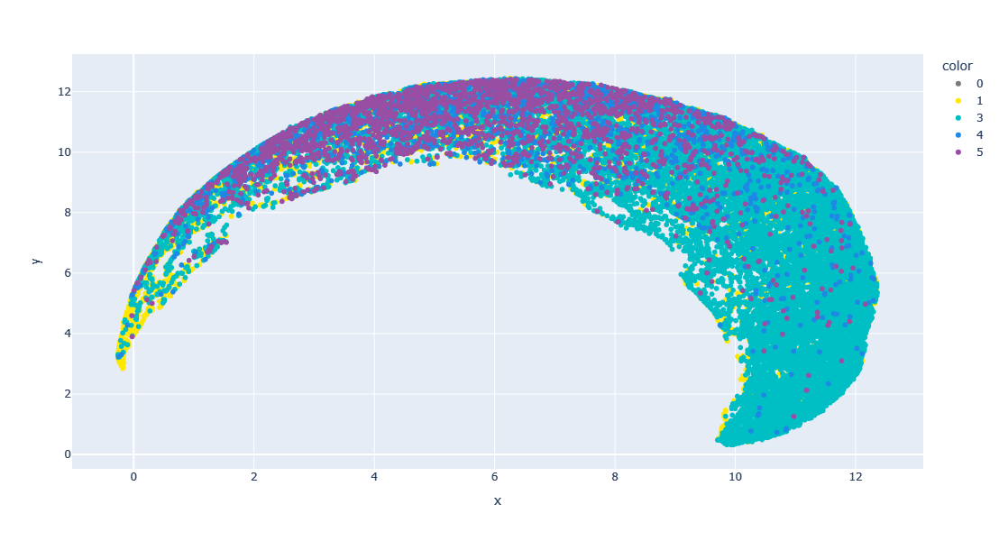

In [22]:
fig = px.scatter(x=emb[:,0], y=emb[:,1],
              color=metrics['State'], color_discrete_map=state_color_map)

fig.update_layout(coloraxis_colorbar_title_text = 'State',
                 autosize=False,
                 width=800,
                 height=600,
                 scene=Scene(xaxis=XAxis(title='UMAP-1'),
                            yaxis=YAxis(title='UMAP-2'),
                            zaxis=ZAxis(title='UMAP-3')))
fig.show()

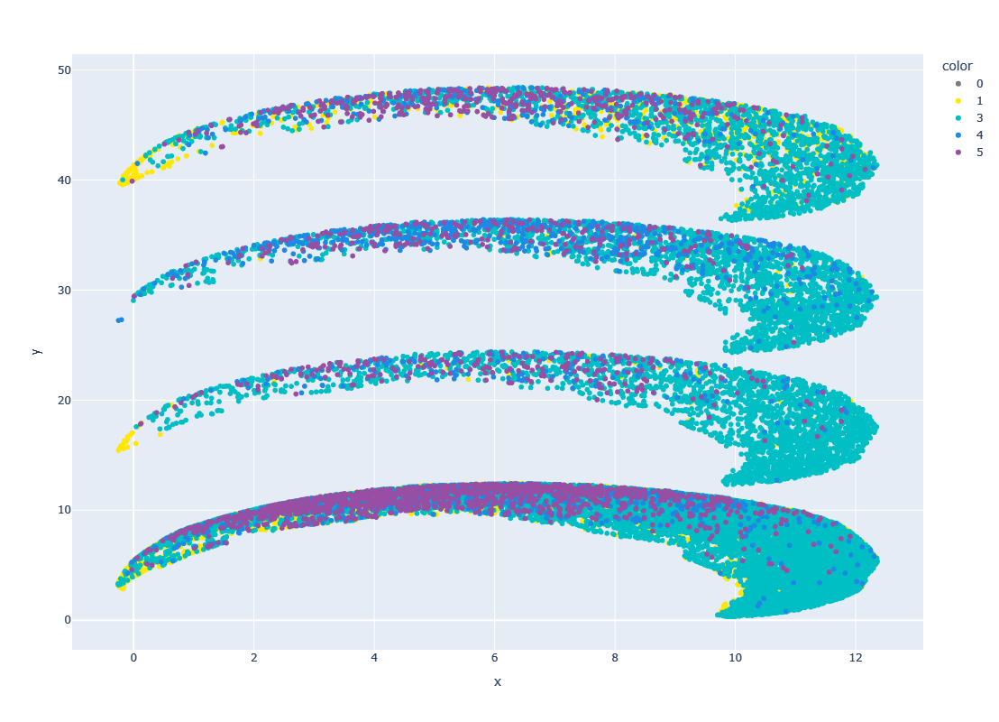

In [28]:
data = metrics
# Assign section based on start_sample and create z_offset using height_offsets
height_offsets = {1: 0, 2: 12, 3: 24, 4: 36}
data['y_offset'] = emb[:, 1] + np.array(data['section'].map(height_offsets))

state_color_map = {
    0: "#7B7B7A",
    1: "#FFE701",
    2: "#F38F0D",
    3: "#00bfc4",
    4: "#1E88E5",
    5: "#984ea3",
}
fig = px.scatter(
    x=emb[:, 0], 
    y=data['y_offset'], 
    color=data['State'], 
    color_discrete_map=state_color_map
)
fig.update_layout(
    coloraxis_colorbar_title_text='State',
    autosize=False,
    width=800,
    height=800,
    scene=dict(
        xaxis=dict(title='UMAP-1'),
        yaxis=dict(title='UMAP-2')
    )
)

fig.show()
# fig.write_html(f"./plots/UMAP-ORN-Whole/{rat}_ORN_split_embedding_1.html")
# fig.write_image("Rat13_ORN_split_embedding.png", engine="kaleido")

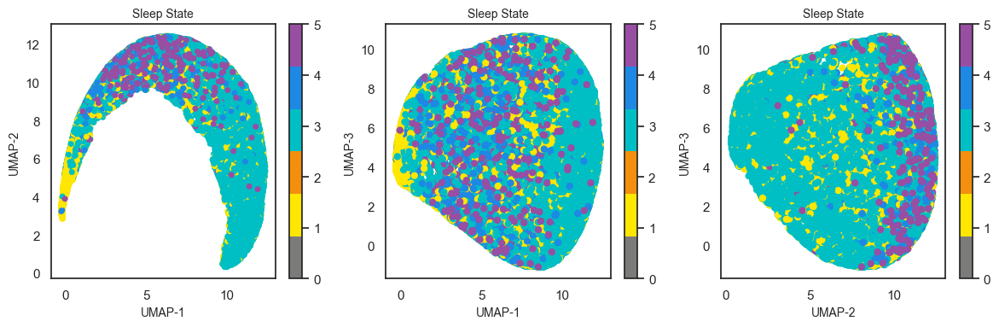

In [34]:
data = metrics

# cmap = plt.get_cmap('gist_rainbow', 6)
# cmap = mpl.colors.ListedColormap(["navy", "crimson", "limegreen", "gold"])
f, ax = plt.subplots(1,3, figsize=(12,4))
s = ax[0].scatter(emb[:,0], emb[:,1], c=data['State'],
            cmap=cmap, s=25, edgecolor ='none')
ax[0].set_xlabel('UMAP-1', fontsize=10)
ax[0].set_ylabel('UMAP-2', fontsize=10)
ax[0].set_title('Sleep State', fontsize=10)
f.colorbar(s, ax=ax[0])

s = ax[1].scatter(emb[:,0], emb[:,2], c=data['State'],
            cmap=cmap, s=25)
ax[1].set_xlabel('UMAP-1', fontsize=10)
ax[1].set_ylabel('UMAP-3', fontsize=10)
ax[1].set_title('Sleep State', fontsize=10)
f.colorbar(s, ax=ax[1])

s = ax[2].scatter(emb[:,1], emb[:,2], c=data['State'],
            cmap=cmap, s=25)
ax[2].set_xlabel('UMAP-2', fontsize=10)
ax[2].set_ylabel('UMAP-3', fontsize=10)
ax[2].set_title('Sleep State', fontsize=10)
f.colorbar(s, ax=ax[2])

plt.tight_layout()
# plt.savefig("./plots/UMAP-ORN-Whole/{rat}_ORN_2D_embedding.png")

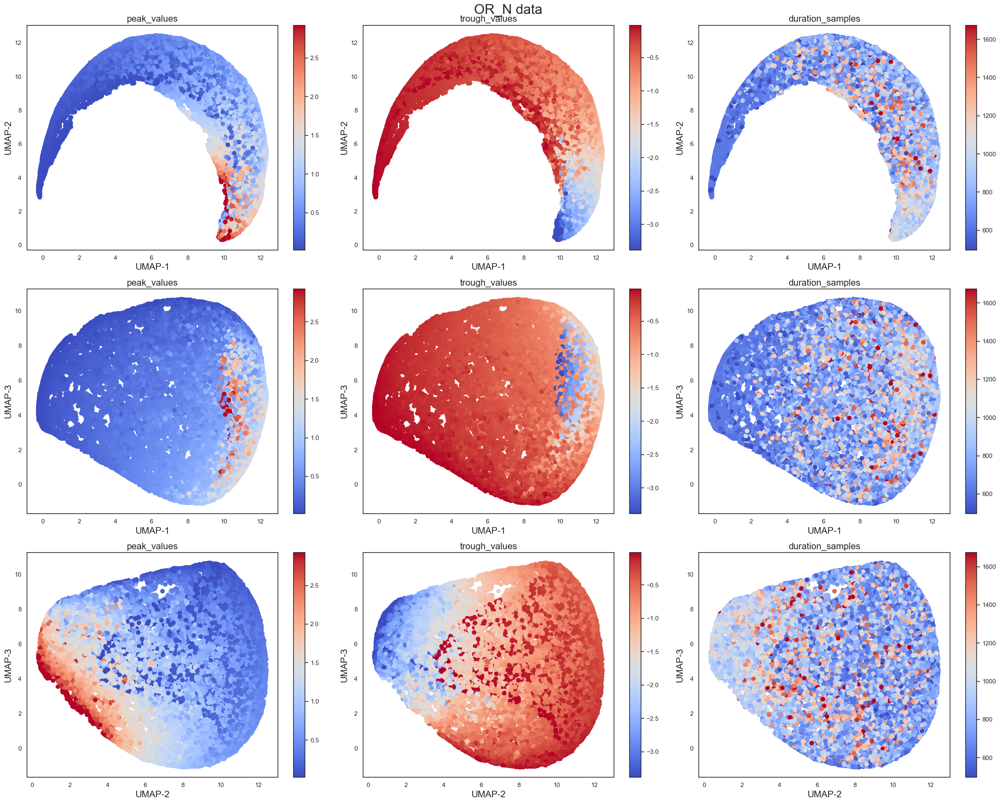

In [36]:
data = metrics

f, ax = plt.subplots(3,3, figsize=(25,20))
s = ax[0,0].scatter(emb[:,0], emb[:,1], c=data['peak_values'],
            vmin=np.percentile(data['peak_values'],1),
            vmax=np.percentile(data['peak_values'],99),
            cmap='coolwarm', s=50)
ax[0,0].set_xlabel('UMAP-1', fontsize=16)
ax[0,0].set_ylabel('UMAP-2', fontsize=16)
ax[0,0].set_title('peak_values', fontsize=16)
f.colorbar(s, ax=ax[0,0])

s = ax[0,1].scatter(emb[:,0], emb[:,1], c=data['trough_values'],
            vmin=np.percentile(data['trough_values'],1),
            vmax=np.percentile(data['trough_values'],99),
            cmap='coolwarm', s=50)
ax[0,1].set_xlabel('UMAP-1', fontsize=16)
ax[0,1].set_ylabel('UMAP-2', fontsize=16)
ax[0,1].set_title('trough_values', fontsize=16)
f.colorbar(s, ax=ax[0,1])

s = ax[0,2].scatter(emb[:,0], emb[:,1], c=data['duration_samples'],
            vmin=np.percentile(data['duration_samples'],1),
            vmax=np.percentile(data['duration_samples'],99),
            cmap='coolwarm', s=50)
ax[0,2].set_xlabel('UMAP-1', fontsize=16)
ax[0,2].set_ylabel('UMAP-2', fontsize=16)
ax[0,2].set_title('duration_samples', fontsize=16)
f.colorbar(s, ax=ax[0,2])
####################################################################

s = ax[1,0].scatter(emb[:,0], emb[:,2], c=data['peak_values'],
            vmin=np.percentile(data['peak_values'],1),
            vmax=np.percentile(data['peak_values'],99),
            cmap='coolwarm', s=50)
ax[1,0].set_xlabel('UMAP-1', fontsize=16)
ax[1,0].set_ylabel('UMAP-3', fontsize=16)
ax[1,0].set_title('peak_values', fontsize=16)
f.colorbar(s, ax=ax[1,0])

s = ax[1,1].scatter(emb[:,0], emb[:,2], c=data['trough_values'],
            vmin=np.percentile(data['trough_values'],1),
            vmax=np.percentile(data['trough_values'],99),
            cmap='coolwarm', s=50)
ax[1,1].set_xlabel('UMAP-1', fontsize=16)
ax[1,1].set_ylabel('UMAP-3', fontsize=16)
ax[1,1].set_title('trough_values', fontsize=16)
f.colorbar(s, ax=ax[1,1])

s = ax[1,2].scatter(emb[:,0], emb[:,2], c=data['duration_samples'],
            vmin=np.percentile(data['duration_samples'],1),
            vmax=np.percentile(data['duration_samples'],99),
            cmap='coolwarm', s=50)
ax[1,2].set_xlabel('UMAP-1', fontsize=16)
ax[1,2].set_ylabel('UMAP-3', fontsize=16)
ax[1,2].set_title('duration_samples', fontsize=16)
f.colorbar(s, ax=ax[1,2])
####################################################################

s = ax[2,0].scatter(emb[:,1], emb[:,2], c=data['peak_values'],
            vmin=np.percentile(data['peak_values'],1),
            vmax=np.percentile(data['peak_values'],99),
            cmap='coolwarm', s=50)
ax[2,0].set_xlabel('UMAP-2', fontsize=16)
ax[2,0].set_ylabel('UMAP-3', fontsize=16)
ax[2,0].set_title('peak_values', fontsize=16)
f.colorbar(s, ax=ax[2,0])

s = ax[2,1].scatter(emb[:,1], emb[:,2], c=data['trough_values'],
            vmin=np.percentile(data['trough_values'],1),
            vmax=np.percentile(data['trough_values'],99),
            cmap='coolwarm', s=50)
ax[2,1].set_xlabel('UMAP-2', fontsize=16)
ax[2,1].set_ylabel('UMAP-3', fontsize=16)
ax[2,1].set_title('trough_values', fontsize=16)
f.colorbar(s, ax=ax[2,1])

s = ax[2,2].scatter(emb[:,1], emb[:,2], c=data['duration_samples'],
            vmin=np.percentile(data['duration_samples'],1),
            vmax=np.percentile(data['duration_samples'],99),
            cmap='coolwarm', s=50)
ax[2,2].set_xlabel('UMAP-2', fontsize=16)
ax[2,2].set_ylabel('UMAP-3', fontsize=16)
ax[2,2].set_title('duration_samples', fontsize=16)
f.colorbar(s, ax=ax[2,2])
####################################################################

plt.suptitle("OR_N data", fontsize=24);
f.tight_layout()
# plt.savefig("./plots/UMAP-ORN-Whole/{rat}_ORN_2D_embedding_features.png")

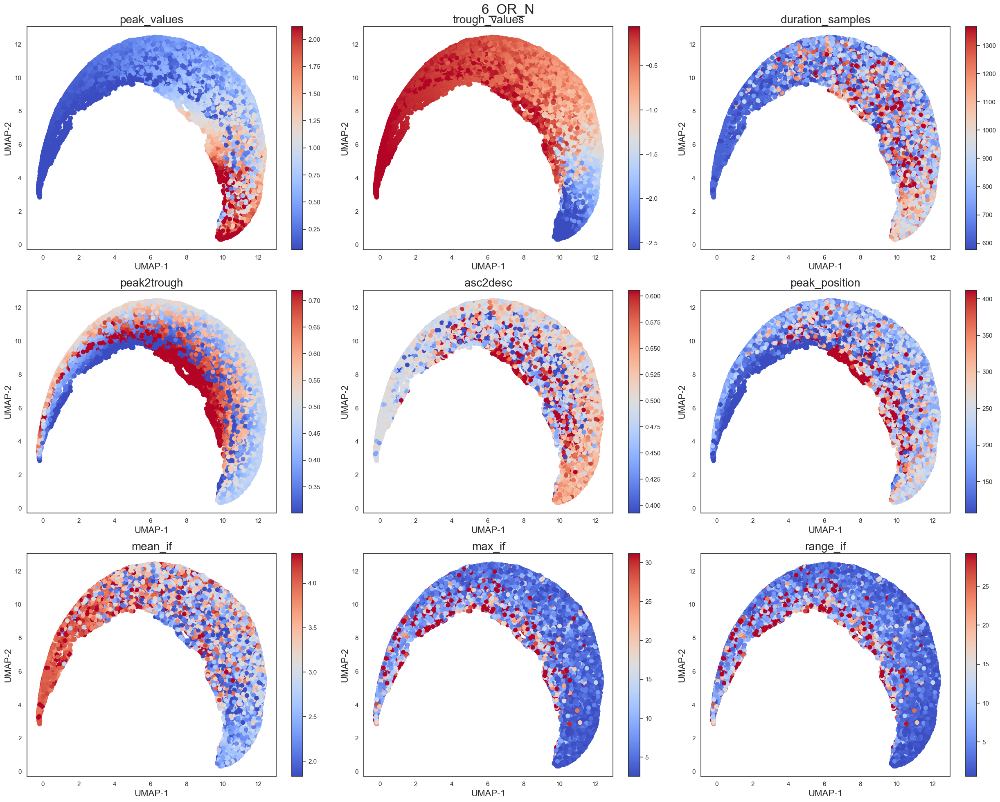

In [38]:
data = metrics

f, ax = plt.subplots(3,3, figsize=(25,20))

features = ['peak_values','trough_values','duration_samples', 'peak2trough', 'asc2desc', 'peak_position', 'mean_if', 'max_if','range_if']
feature_iter = iter(features)

for r in range(3):
    for c in range(3):
        feature = next(feature_iter)
        s = ax[r,c].scatter(emb[:,0], emb[:,1], c=data[feature],
            vmin=np.percentile(data[feature],5),
            vmax=np.percentile(data[feature],95),
            cmap='coolwarm', s=50)
        ax[r,c].set_xlabel('UMAP-1', fontsize=16)
        ax[r,c].set_ylabel('UMAP-2', fontsize=16)
        ax[r,c].set_title(feature, fontsize=20)
        f.colorbar(s, ax=ax[r,c])

plt.suptitle(f"{rat}_OR_N", fontsize=24);
f.tight_layout()
# plt.savefig(f"./plots/UMAP-ORN-Whole/Rat_{rat}_ORN_HPC_2D_embedding_features.png")

### 3D Plots

In [ ]:
# 3D plot of sleep states projected on UMAP
data = metrics
feature = 'peak_values'

fig = px.scatter_3d(x=emb[:,0], y=emb[:,1], z=emb[:,2],
              color=data[feature], color_discrete_map=state_color_map)
fig.update_layout(autosize=False,
                 width=800,
                 height=600,
                 scene=Scene(xaxis=XAxis(title='UMAP-1'),
                            yaxis=YAxis(title='UMAP-2'),
                            zaxis=ZAxis(title='UMAP-3')),
                      coloraxis_colorbar_title=feature,
                 legend_title_text="State",
)
fig.show()
# fig.write_html(f"./plots/UMAP-ORN-Whole/Resampled-Waveforms/Rat{rat}/Rat_{rat}_ORN_PFC_embedding_state.html")
# fig.write_image("Rat6_ORN_PFC_3D_embedding.png", engine="kaleido")

In [ ]:
# 3D plots of features projected on UMAP - Save to plots
features = ['duration_samples', 'peak2trough', 'asc2desc', 'max_amp','trough_values', 'peak_values', 'mean_if', 'max_if', 'range_if', 'State']
data = metrics

for feature in features:
    fig = px.scatter_3d(x=emb[:,0], y=emb[:,1], z=emb[:,2],
                  color=data[feature])
    fig.update_layout(autosize=False,
                      width=800,
                      height=600,
                      scene=Scene(xaxis=XAxis(title='UMAP-1'),
                                yaxis=YAxis(title='UMAP-2'),
                                zaxis=ZAxis(title='UMAP-3')),
                      coloraxis_colorbar_title=feature,
    )
    # fig.show()
    # fig.write_html(f"./plots/UMAP-ORN-Whole/Resampled-Waveforms/Rat{rat}/Rat_{rat}_ORN_PFC_embedding_{feature}.html")

In [ ]:
# Split 3D plot with projected sleep states
data = metrics

# Assign section based on start_sample and create z_offset using height_offsets
height_offsets = {1: 0, 2: 10, 3: 20, 4: 30}
data['z_offset'] = emb[:, 2] + np.array(data['section'].map(height_offsets))

fig = px.scatter_3d(
    x=emb[:, 0], 
    y=emb[:, 1], 
    z=data['z_offset'],
    color=data['State'], 
    color_discrete_map=state_color_map
)

for section, z_pos in height_offsets.items():
    fig.add_trace(
        go.Scatter3d(
            x=[-5], y=[10], z=[z_pos + 5],
            mode='text',
            text=f"{(section-1)*45} - {section*45} minutes",
            textfont=dict(size=12, color='black'),
            showlegend=False
        )
    )

fig.update_layout(
    coloraxis_colorbar_title_text='State',
    autosize=False,
    width=800,
    height=800,
    scene=dict(
        xaxis=dict(title='UMAP-1'),
        yaxis=dict(title='UMAP-2'),
        zaxis=dict(title='UMAP-3')
    ),
    legend_title_text="State"
)

fig.show()
# fig.write_html(f"./plots/UMAP-ORN-Whole/Resampled-Waveforms/Rat{rat}/Rat_{rat}_ORN_PFC_split_embedding_state.html")

### Waveforms

In [ ]:
# emb_data = pd.DataFrame(embedding.embedding_)
component = 1

In [ ]:
low_embedding_indices = np.where(emb[:, component-1] <= np.percentile(emb[:, component-1], 15))[0]
low_waveforms = waveforms[low_embedding_indices]

high_embedding_indices = np.where(emb[:, component-1] >= np.percentile(emb[:, component-1], 85))[0]
high_waveforms = waveforms[high_embedding_indices]

In [ ]:
# Average waveforms
plt.figure(figsize=(10,5), facecolor='white')
plt.suptitle(f"{rat} OR_N PFC")
plt.subplot(1, 2, 1)

means = np.mean(low_waveforms, axis=0)
x_values = np.arange(len(means))
std = np.std(low_waveforms, axis=0)
lower_bound = np.array(means) - np.array(std)
upper_bound = np.array(means) + np.array(std)
sns.lineplot(means)
plt.fill_between(x_values, lower_bound, upper_bound, color='blue', alpha=0.2)
plt.ylabel('Potential')
plt.ylim(-4, 4)
plt.title(f'<= 15 percentile on UMAP-{component}');

plt.subplot(1, 2, 2)
means = np.mean(high_waveforms, axis=0)
std = np.std(high_waveforms, axis=0)
lower_bound = np.array(means) - np.array(std)
upper_bound = np.array(means) + np.array(std)
sns.lineplot(means)
plt.fill_between(x_values, lower_bound, upper_bound, color='blue', alpha=0.2);
plt.ylabel('Potential')
plt.ylim(-4, 4)
plt.title(f'>= 85 percentile on UMAP-{component}');
plt.tight_layout()
# plt.savefig(f"./plots/UMAP-ORN-Whole/Rat{rat}/Rat_{rat}_ORN_PFC_waveforms.png")

In [ ]:
plt.figure(figsize=(6,10), facecolor='white')
plt.suptitle(f"{rat} OR_N PFC")
plt.subplot(1, 2, 1)
plt.title(f'<= 20 percentile on UMAP-{component}')
start = 0
cycles_to_plot = np.random.randint(1, low_waveforms.shape[0], 30)
for i in cycles_to_plot:
  plt.plot(low_waveforms[i,:]+start)
  start += 3
plt.ylim((-5, 100))

plt.subplot(1, 2, 2)
plt.title(f'>= 80 percentile on UMAP-{component}')
start = 0
cycles_to_plot = np.random.randint(1, high_waveforms.shape[0], 30)
for i in cycles_to_plot:
  plt.plot(high_waveforms[i,:]+start)
  start += 3
plt.ylim((-5, 100))

plt.tight_layout()
# plt.savefig(f"./plots/UMAP-ORN-Whole/Rat{rat}/Rat_{rat}_ORN_PFC_waveform_examples.png")

### Inverse Transformed from UMAP

In [ ]:
resolution = 20
x_min, x_max = emb[:, 0].min(), emb[:, 0].max()
y_min, y_max = emb[:, 1].min(), emb[:, 1].max()
z_min, z_max = emb[:, 2].min(), emb[:, 2].max()
x = np.linspace(x_min, x_max, resolution)
y = np.linspace(y_min, y_max, resolution)
z = np.linspace(z_min, z_max, resolution)
X, Y, Z = np.meshgrid(x, y, z, indexing='ij')
grid_points = np.column_stack((X.ravel(), Y.ravel(), Z.ravel()))

In [ ]:
import plotly.graph_objects as go
fig = go.Figure(data=go.Scatter3d(
    x=grid_points[:, 0],
    y=grid_points[:, 1],
    z=grid_points[:, 2],
    mode='markers',
    marker=dict(size=2, opacity=0.6)))
fig.update_layout(autosize=False,width=400,height=400,
    scene=Scene(xaxis=XAxis(title='UMAP-1'),
                            yaxis=YAxis(title='UMAP-2'),
                            zaxis=ZAxis(title='UMAP-3')))
fig.show()

In [ ]:
inv = embedding.inverse_transform(grid_points)
inv = inv.reshape(X.shape + (-1,))

In [ ]:
fig = go.Figure()
colorscale = 'Viridis'
x_norm = (x - x.min()) / (x.max() - x.min())
cmap = plt.get_cmap('viridis')

for i in range(inv.shape[0]):
    color = f'rgba{cmap(x_norm[i])}'
    fig.add_trace(go.Scatter(
        y=inv[i, 0, 0, :],
        mode='lines', line=dict(color=color, width=2)))
fig.add_trace(go.Scatter(x=[None], y=[None],mode='markers',
        marker=dict(size=0,color=x,colorscale=colorscale,
            colorbar=dict(
                title="UMAP-1 values",
                tickvals=x,
                ticktext=[f"{val:.2f}" for val in x],),),
        hoverinfo='none',))
fig.update_layout(
    autosize=False,
    width=800,
    height=600,
    title=f"Inverse-transformed waveforms at UMAP-2={y[0]:.2f} and UMAP-3={z[0]:.2f}",
    xaxis_title="Time (128 points)",
    yaxis_title="Potential",
    showlegend=False)
fig.show()
# fig.write_html(f"./plots/UMAP-ORN-Whole/Rat1-UMAP-waveforms/Rat_{rat}_ORN_PFC_waveform_2.html")

In [ ]:
from plotly.subplots import make_subplots

subplot_titles = [f'UMAP-2={y[j]:.2f}\nUMAP-3={z[i]:.2f}' for i in range(len(z)) for j in range(len(y))]

colorscale = 'Viridis'
cmap = plt.get_cmap('viridis')
fig = make_subplots(rows=3, cols=3,horizontal_spacing=0.05,vertical_spacing=0.05,
                   subplot_titles=subplot_titles)

for row in range(1,4):
    for col in range(1,4):
        for i in range(inv.shape[0]):
            color = f'rgba{cmap(x_norm[i])}'
            fig.add_trace(go.Scatter(
                y=inv[i, col-1, row-1, :],
                mode='lines', 
                line=dict(color=color, width=2),
                name=f"x={x[i]:.2f}",
                hoverinfo='x+y'),
                row=row, col=col)

fig.add_trace(go.Scatter(
    x=[None], y=[None], mode='markers',
    marker=dict(size=0, color=x, colorscale=colorscale,
                colorbar=dict(
                    title="UMAP-1 values",
                    tickvals=x,
                    ticktext=[f"{val:.2f}" for val in x])),
    hoverinfo='none'))

fig.update_layout(
    autosize=False,
    width=1000,
    height=1000,
    # title=f"Inverse-transformed waveforms at UMAP-2={y[0]:.2f} and UMAP-3={z[0]:.2f}",
    yaxis_title="Potential",
    showlegend=False)
fig.show()
# fig.write_html(f"./plots/UMAP-ORN-Whole/Rat1-UMAP-waveforms/Rat_{rat}_ORN_PFC_waveform_3.html")

### Centroid Trajectory

In [51]:
# Get centroids of Post-Trial5
idx = np.where((metrics['section'] == 1) & (metrics['Post_Trial'] == 5))[0]
centroid_section1 = np.mean(emb[idx], axis=0)

idx = np.where((metrics['section'] == 2) & (metrics['Post_Trial'] == 5))[0]
centroid_section2 = np.mean(emb[idx], axis=0)

idx = np.where((metrics['section'] == 3) & (metrics['Post_Trial'] == 5))[0]
centroid_section3 = np.mean(emb[idx], axis=0)

idx = np.where((metrics['section'] == 4) & (metrics['Post_Trial'] == 5))[0]
centroid_section4 = np.mean(emb[idx], axis=0)

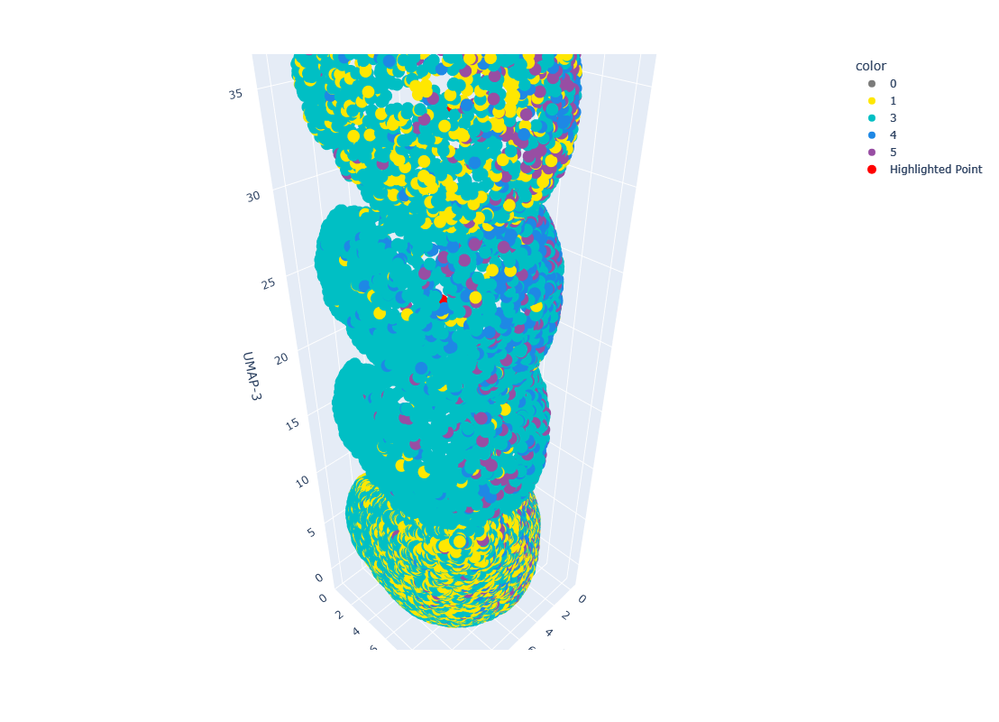

In [55]:
data = metrics

# Assign section based on start_sample and create z_offset using height_offsets
height_offsets = {1: 0, 2: 10, 3: 20, 4: 30}
data['z_offset'] = emb[:, 2] + np.array(data['section'].map(height_offsets))

state_color_map = {
    0: "#7B7B7A",
    1: "#FFE701",
    2: "#F38F0D",
    3: "#00bfc4",
    4: "#1E88E5",
    5: "#984ea3",
}

fig = px.scatter_3d(
    x=emb[:, 0], 
    y=emb[:, 1], 
    z=data['z_offset'],
    color=data['State'], 
    color_discrete_map=state_color_map
)

fig.add_scatter3d(
    x=[centroid_section1[0],centroid_section2[0],centroid_section3[0],centroid_section4[0]],
    y=[centroid_section1[1],centroid_section2[1],centroid_section3[1],centroid_section4[1]],
    z=[centroid_section1[2],centroid_section2[2]+height_offsets[2],centroid_section3[2]+height_offsets[3],centroid_section4[2]+height_offsets[4]],
    mode='markers',
    marker=dict(size=10, color='red', symbol='circle', opacity=1),
    name='Highlighted Point'  # Optional legend label
)

fig.update_layout(
    coloraxis_colorbar_title_text='State',
    autosize=False,
    width=800,
    height=800,
    scene=dict(
        xaxis=dict(title='UMAP-1'),
        yaxis=dict(title='UMAP-2'),
        zaxis=dict(title='UMAP-3')
    )
)

fig.show()
# fig.write_html("./plots/PostTrial_5/PostTrial5_state5_split_embedding.html")
# fig.write_image("Rat6_ORN_3D_embedding.png", engine="kaleido")

### Structure Index

In [120]:
state=3

In [138]:
metrics['section'] = metrics['start_sample'].apply(get_section)

In [202]:
metrics = metrics.reset_index()

In [204]:
metrics_section1 = metrics[(metrics['section'] == 1)]
metrics_section2 = metrics[(metrics['section'] == 2)]
metrics_section3 = metrics[(metrics['section'] == 3)]
metrics_section4 = metrics[(metrics['section'] == 4)]
emb_section1 = np.copy(emb[metrics_section1.index])
emb_section2 = np.copy(emb[metrics_section2.index])
emb_section3 = np.copy(emb[metrics_section3.index])
emb_section4 = np.copy(emb[metrics_section4.index])

In [214]:
params = {
    'n_bins': 6,
    'n_neighbors': 15,
    'discrete_label': False,
    'num_shuffles': 10,
    'verbose': False,
}

In [216]:
SI1, binLabel1, overlapMat1, sSI1 = compute_structure_index(emb_section1, np.array(metrics_section1['peak_values']), **params)
SI2, binLabel2, overlapMat2, sSI2 = compute_structure_index(emb_section2, np.array(metrics_section2['peak_values']), **params)
SI3, binLabel3, overlapMat3, sSI3 = compute_structure_index(emb_section3, np.array(metrics_section3['peak_values']), **params)
SI4, binLabel4, overlapMat4, sSI4 = compute_structure_index(emb_section4, np.array(metrics_section4['peak_values']), **params)

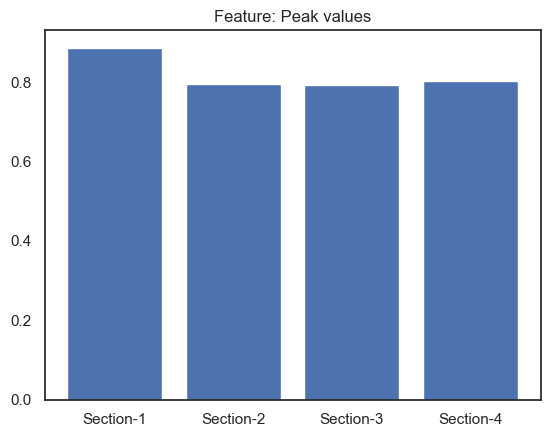

In [217]:
D = {'Section-1':SI1, 'Section-2': SI2, 'Section-3': SI3, 'Section-4':SI4}

plt.bar(range(len(D)), list(D.values()), align='center')
plt.xticks(range(len(D)), list(D.keys()))
plt.title('Feature: Peak values');

In [220]:
def plot_SI(emb, feature, overlapMat, binLabel, SI):
    fig, ax = plt.subplots(1, 3, figsize=(18,5))
    
    # plot 3D scatter
    # also you can set vmin and vmax to your specific data
    at = plt.subplot(1,3,1,projection = '3d')
    b = at.scatter(*emb[:, :3].T, c = np.array(feature), cmap = 'coolwarm',
                   vmin= np.percentile(feature,1),
                   vmax = np.percentile(feature,99))
    cbar = fig.colorbar(b,ax=at,anchor=(0, 0.3), shrink=0.8)
    cbar.set_label('Peak Values', rotation=90)
    at.set_title(f'3D plot', size=16);
    at.set_xlabel('Dim 1', labelpad=-8, size=14)
    at.set_ylabel('Dim 2', labelpad=-8, size=14)
    at.set_zlabel('Dim 3', labelpad=-8, size=14)
    at.set_xticks([])
    at.set_yticks([])
    at.set_zticks([])
    
    # plot adjacency matrix
    b = ax[1].matshow(overlapMat, vmin = 0, vmax = 0.5, cmap = plt.cm.viridis)
    ax[1].xaxis.set_ticks_position('bottom')
    cbar = fig.colorbar(b,ax=ax[1],anchor=(0, 0.2), shrink=1, ticks=[0,0.25,0.5])
    cbar.set_label('overlap score', rotation=90, fontsize = 14)
    ax[1].set_title('Adjacency matrix', size=16);
    ax[1].set_xlabel('bin-groups', size=14)
    ax[1].set_ylabel('bin-groups', size=14)
    
    # plot weighted directed graph
    draw_graph(overlapMat, ax[2],node_cmap=plt.cm.inferno_r,edge_cmap=plt.cm.Greys,
                                      node_names = np.round(binLabel1[1][:,0,1],2));
    ax[2].set_xlim(1.2*np.array(ax[2].get_xlim()));
    ax[2].set_ylim(1.2*np.array(ax[2].get_ylim()));
    ax[2].set_title('Directed graph', size=16);
    ax[2].text(0.98, 0.05, f"SI: {SI:.2f}", horizontalalignment='right',
         verticalalignment='bottom', transform=ax[2].transAxes,fontsize=25)
    fig.suptitle('Section-1', fontsize=20)
    plt.tight_layout()
    # plt.savefig('orn_1_si.png')

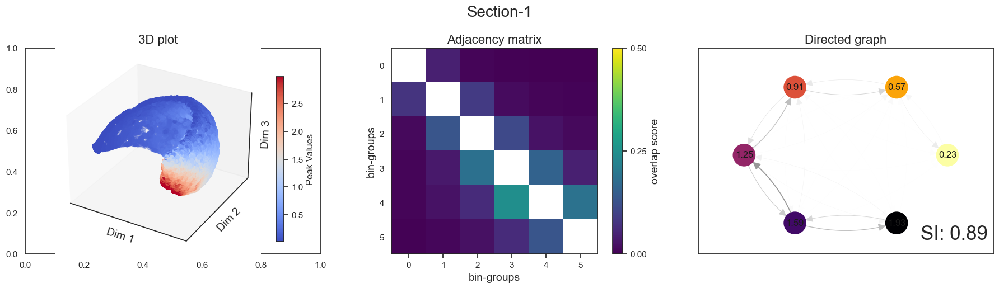

In [224]:
plot_SI(emb_section1, metrics_section1['peak_values'], overlapMat1, binLabel1, SI1)

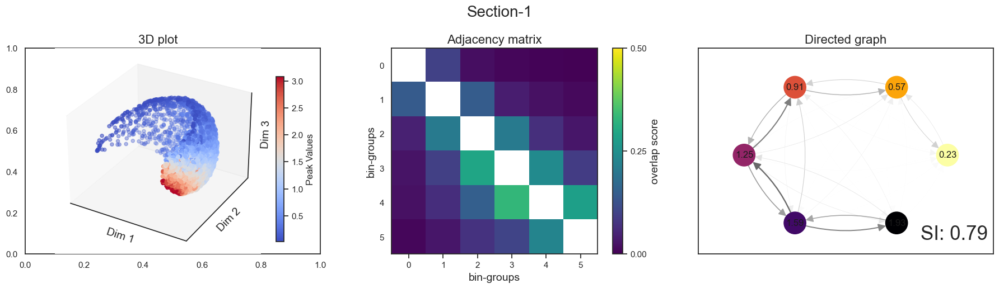

In [225]:
plot_SI(emb_section2, metrics_section2['peak_values'], overlapMat2, binLabel2, SI2)

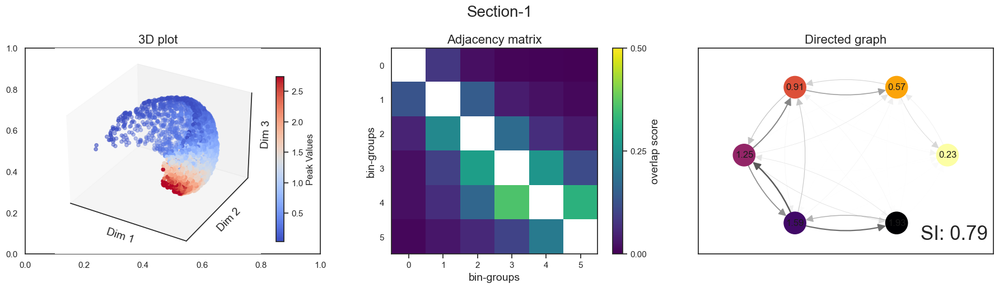

In [228]:
plot_SI(emb_section3, metrics_section3['peak_values'], overlapMat3, binLabel3, SI3)

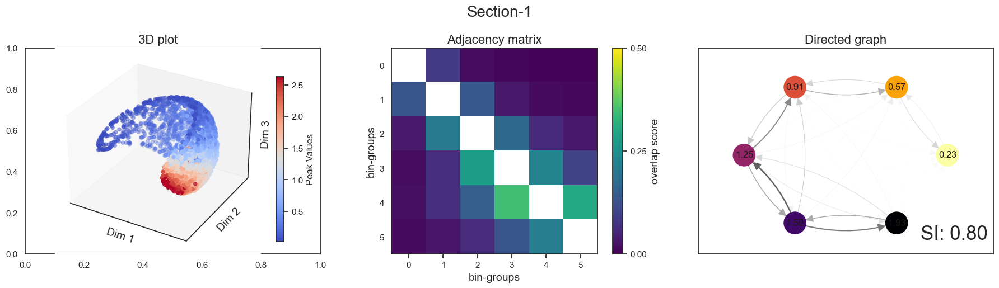

In [230]:
plot_SI(emb_section4, metrics_section4['peak_values'], overlapMat4, binLabel4, SI4)